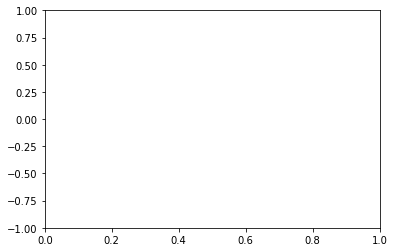

In [1]:
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
import soundfile as sf
import librosa
import torch
import pandas as pd
import re
import IPython.display as ipd
import warnings

import Pytorch_Generator
import AudioDataset

plt.ylim(-1.0, 1.0)
warnings.filterwarnings("ignore", category=UserWarning) 

### Generate 20 samples

In [16]:
generator = Pytorch_Generator.Net()

device = torch.device("cuda")
generator.to(device)

generator.load_state_dict(torch.load("generatorModel9.pt"))
generator.eval()

generator.generate(AudioDataset.NoisyMusicDataset(folderIndex=0), "GeneratorOutput")

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold10/189982-0-0-19.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/2.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold1/57320-0-0-11.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/22.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold1/157867-8-0-8.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/42.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold7/202516-0-0-1.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/62.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold1/146186-5-0-1.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/82.RAW

/home/sebltm/OneDri

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold10/155280-2-0-13.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/842.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold6/175917-3-1-1.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/862.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold9/168906-9-0-114.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/882.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold8/180132-4-3-0.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/902.RAW

/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/audio/fold2/178521-2-0-18.wav
/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/922.RAW

/home/sebl

### Get the original noise and music files

In [2]:
%matplotlib notebook

with open("/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/metadata.txt") as noiseMetadataFile:
    noiseFiles = [line.strip() for line in noiseMetadataFile]

baseFolder = "/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/"
metadataPath = baseFolder + "Sounds/ProcessedTest/metadata.txt"
metadataFile = open(metadataPath)
metadataFData = metadataFile.read()

reg = re.compile("(\/home.*.wav) \+ (\/home.*.mp3)")
originalFiles = reg.findall(metadataFData)

In [3]:
def calculateANC(baseFolder, noisyMusicFolder, ancFolder, mult, offset=2, showGraphs=True, showPlayer=True):
    mses = []
    for i in range(20):

        ogMusic, sr = librosa.load(originalFiles[i * 20 + offset][1].strip(), mono=True, sr=44100, duration=1.30)
        ogNoise, sr = librosa.load(originalFiles[i * 20 + offset][0].strip(), mono=True, sr=44100, duration=1.30)

        noisyMusicFile = baseFolder + noisyMusicFolder + str(i * 20 + offset) + ".RAW"
        noisyMusic = sf.SoundFile(noisyMusicFile, channels=1, samplerate=44100, subtype='FLOAT').read(dtype=np.float, always_2d=False)

        noiseFile = baseFolder + ancFolder + str(i) + ".RAW"
        noise = sf.SoundFile(noiseFile, channels=1, samplerate=44100, subtype='FLOAT').read(dtype=np.float, always_2d=False)
        noiseMult = np.multiply(noise, mult)
        noiseNorm = np.subtract(noiseMult, np.mean(noiseMult))
        noiseInv = np.negative(noiseNorm)

        ancMusic = np.add(noisyMusic, noiseInv)

        if(showGraphs):
            fig, axes = plt.subplots(1, 2, sharey=True)

            axes[0].plot(noisyMusic, label="Original music", alpha=1)
            axes[0].plot(ancMusic, label="Music with cancelled noise", alpha = 0.5)

            axes[1].plot(ogNoise * 1.5, label="Original noise", alpha = 1)
            axes[1].plot(noiseInv / 1.5, label="Inverse of extracted noise", alpha=0.5)

            fig.legend()
            fig.show()
            
        if(showPlayer):
            ogMusicClip    = np.clip(ogMusic,    -1.0, 1.0)
            ogNoiseClip    = np.clip(ogNoise,    -1.0, 1.0)
            ancMusicClip   = np.clip(ancMusic,   -1.0, 1.0)
            noisyMusicClip = np.clip(noisyMusic, -1.0, 1.0)


            print("Original Music")
            ipd.display(ipd.Audio(ogMusicClip,    rate=44100, normalize=False))

            print("Original Noise")
            ipd.display(ipd.Audio(ogNoiseClip,    rate=44100, normalize=False))

            print("Noisy Music")
            ipd.display(ipd.Audio(noisyMusicClip, rate=44100, normalize=False))

            print("Music with ANC")
            ipd.display(ipd.Audio(ancMusicClip,   rate=44100, normalize=False))

        # print("MSE between original noise and inverse extracted noise")
        mse = (np.square(ogNoise - noiseInv)).mean(axis=0)
        mses.append(mse)
        #print((np.square(ogMusic - noiseMult)).mean(axis=0))
        
    print("Average MSE loss for all samples is {}".format(np.mean(mses)))

### Calculate noise cancellation on real noisy music with a generator trained in a supervised manner

<IPython.core.display.Javascript object>


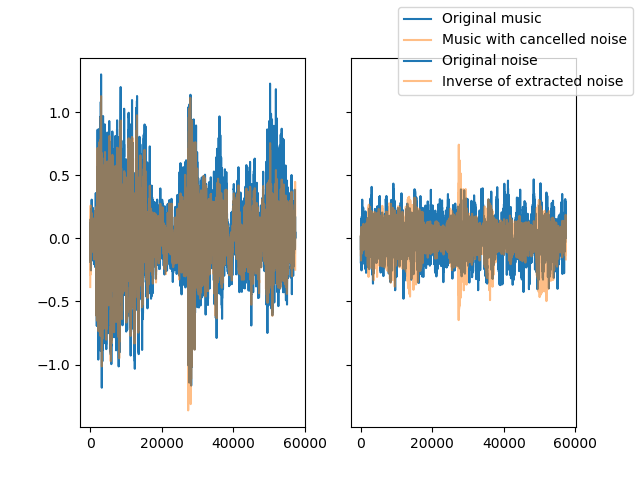

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


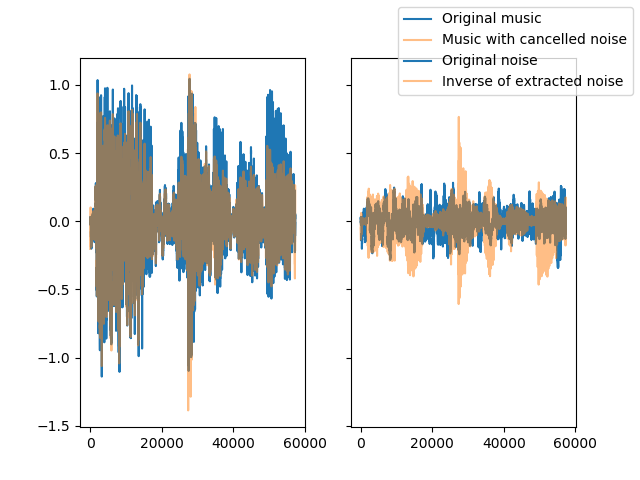

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


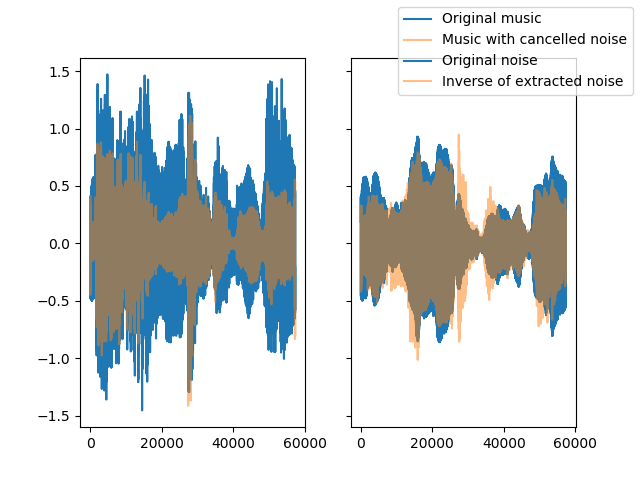

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


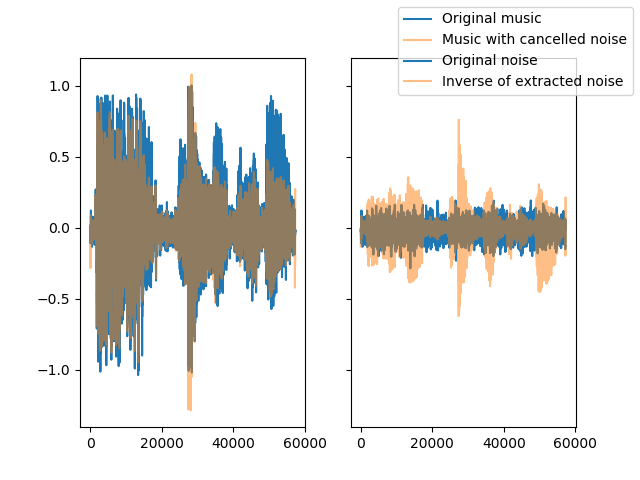

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


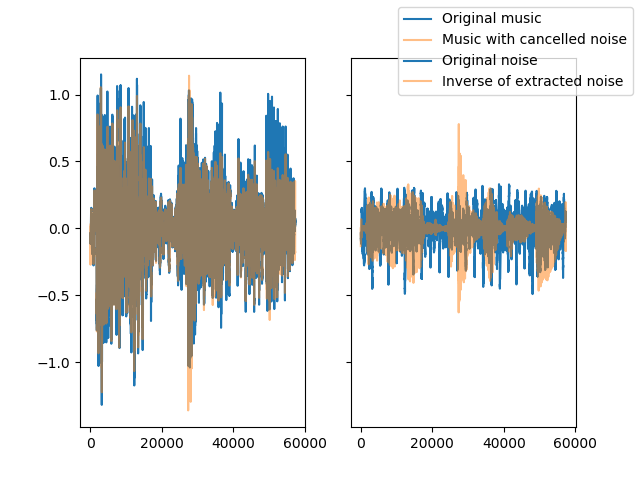

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


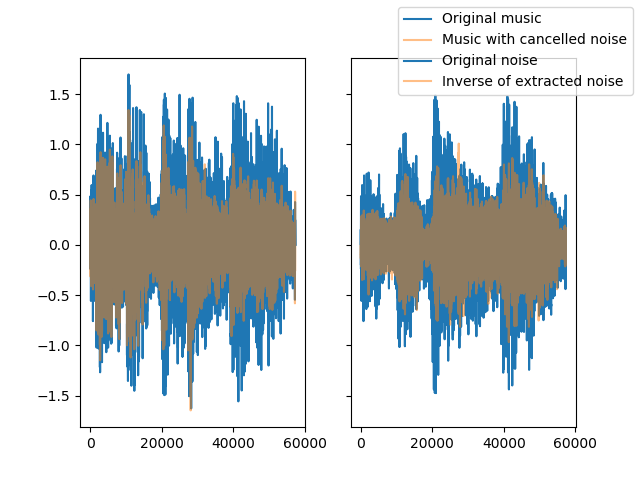

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


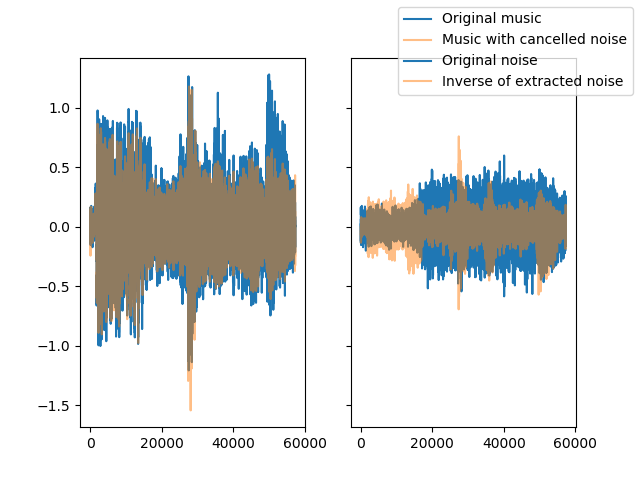

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


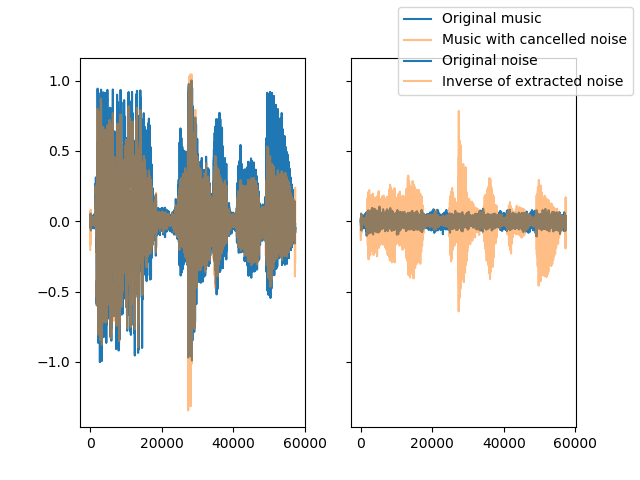

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


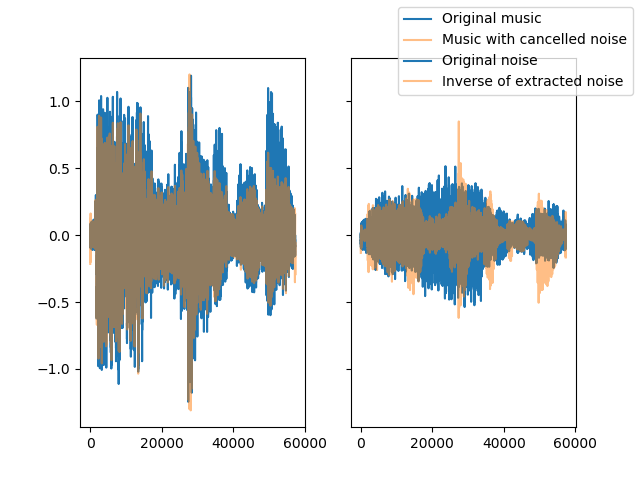

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


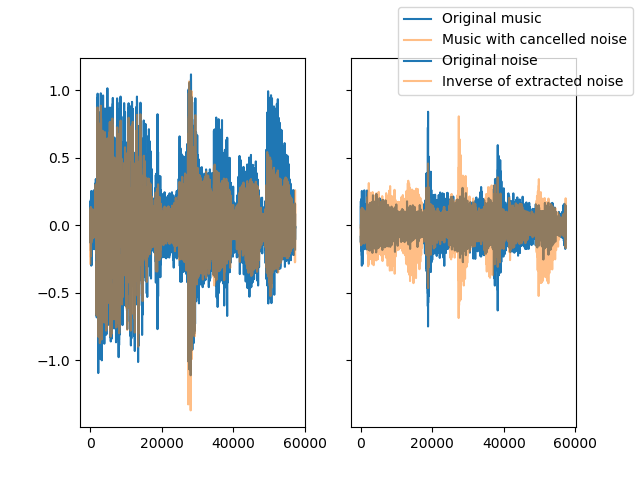

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


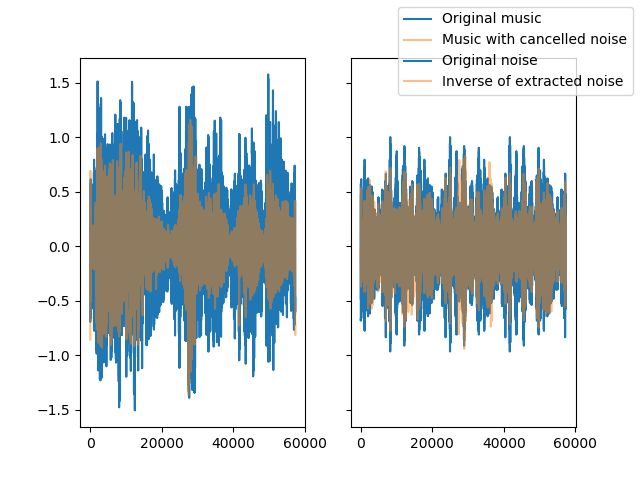

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


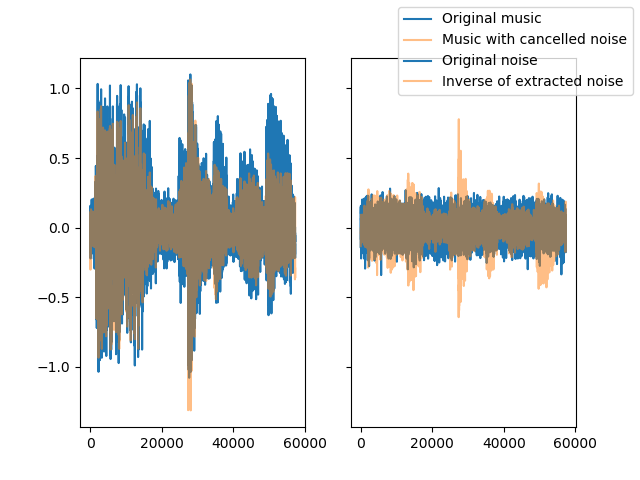

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


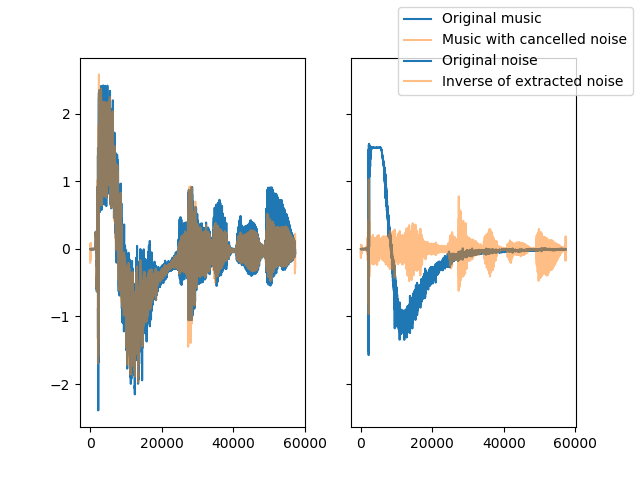

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


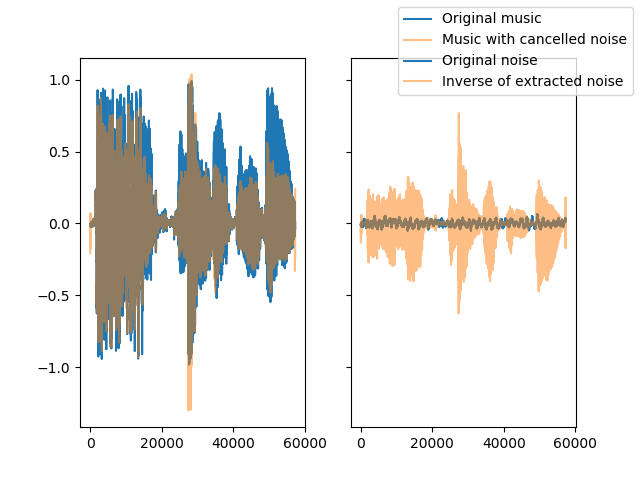

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


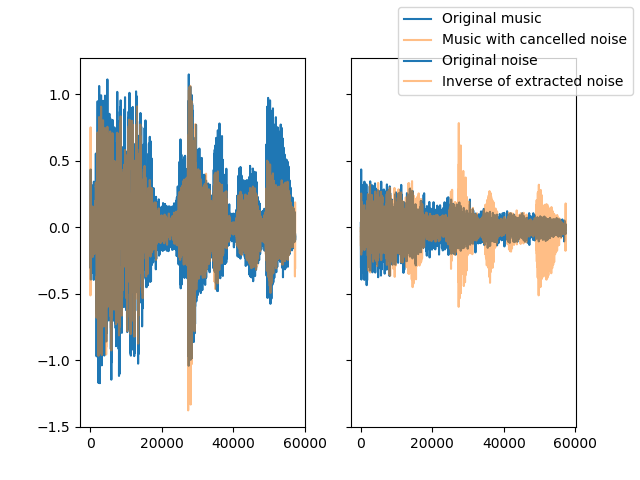

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


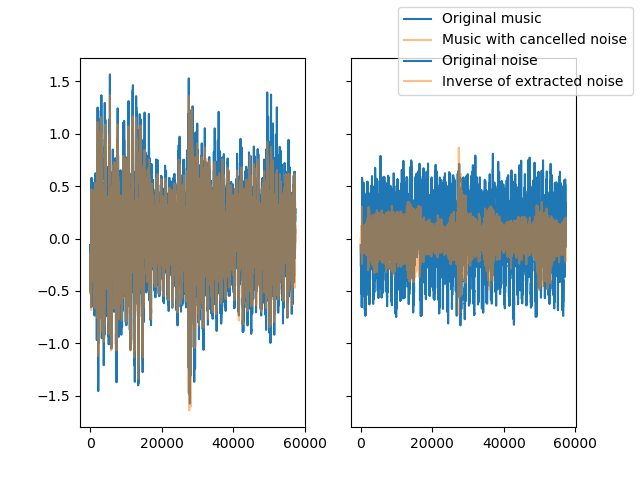

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


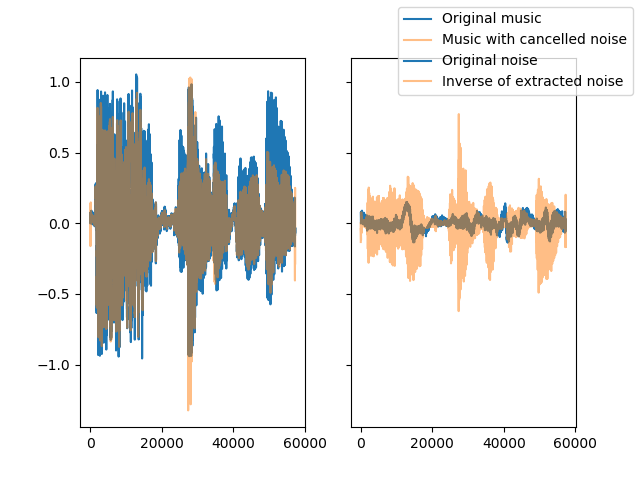

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


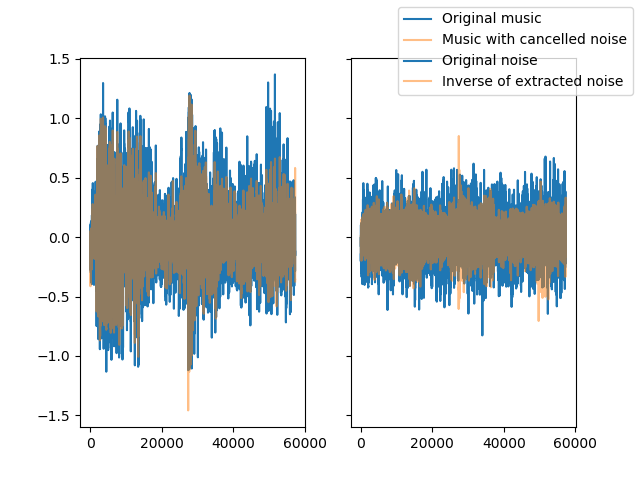

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


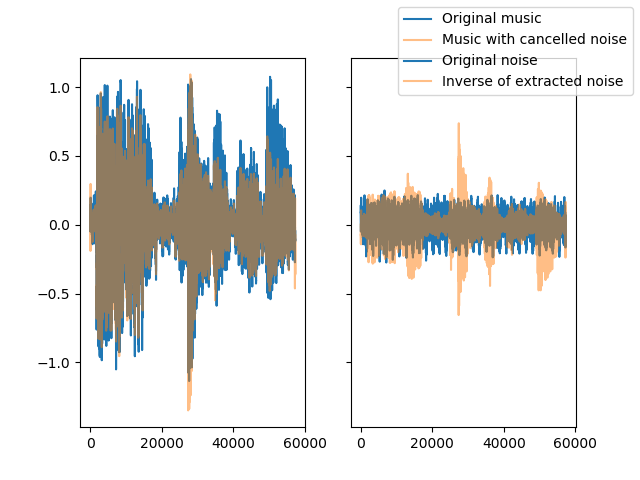

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


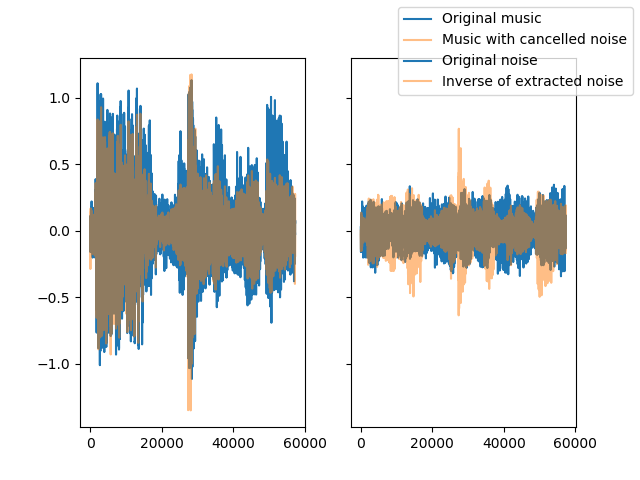

Original Music


Original Noise


Noisy Music


Music with ANC


Average MSE loss for all samples is 0.06886253499100017


In [6]:
%matplotlib notebook

calculateANC(baseFolder, "Sounds/ProcessedTest/fold0/", "GAN-ANC/GeneratorOutput/", mult=2.6)

### Calculate noise cancellation on real noisy music with a generator trained using a Generative Adversarial Network

<IPython.core.display.Javascript object>


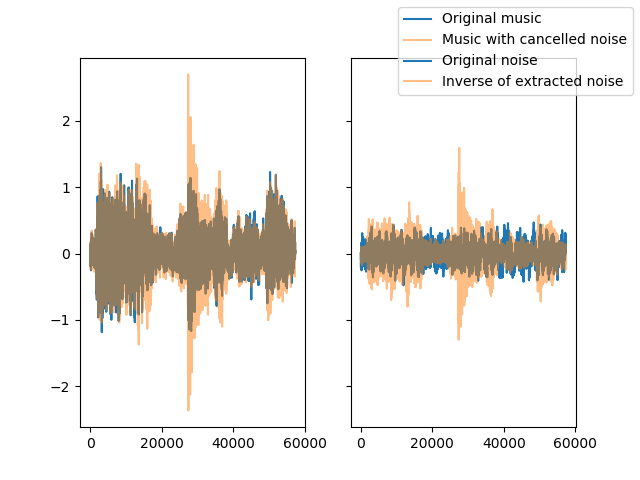

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


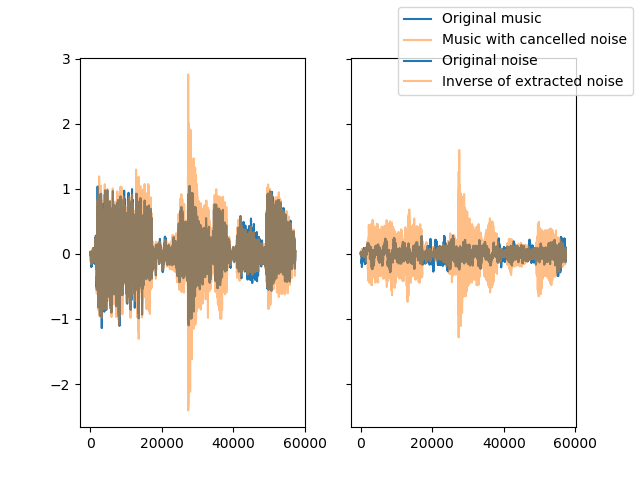

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


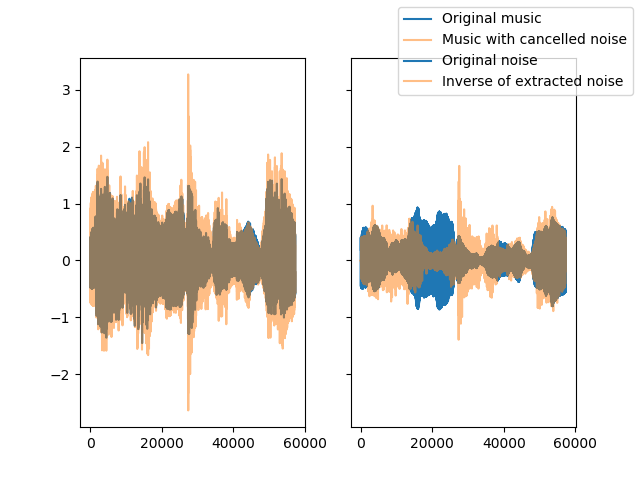

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


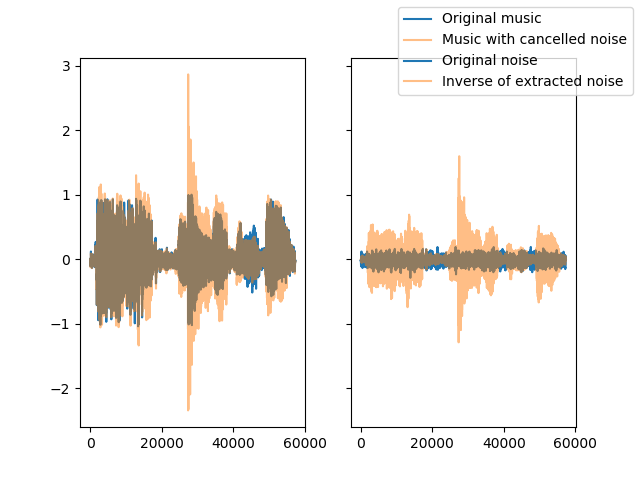

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


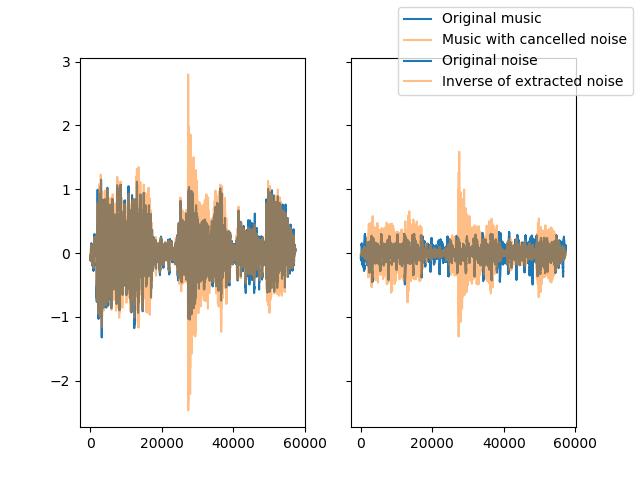

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


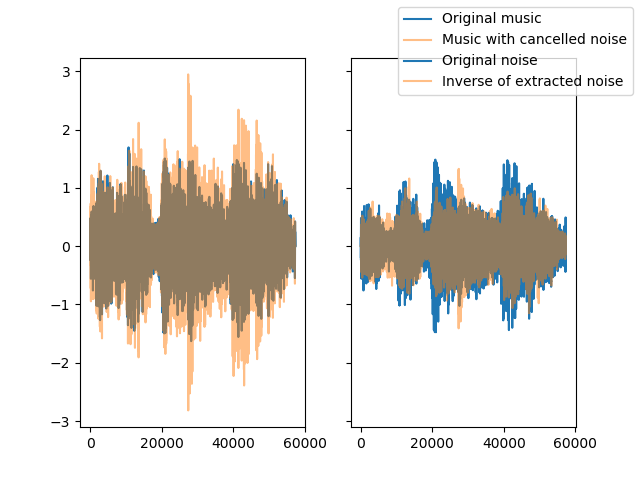

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


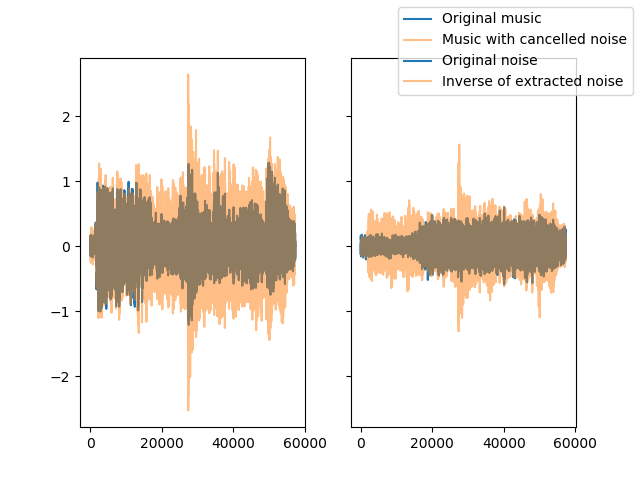

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


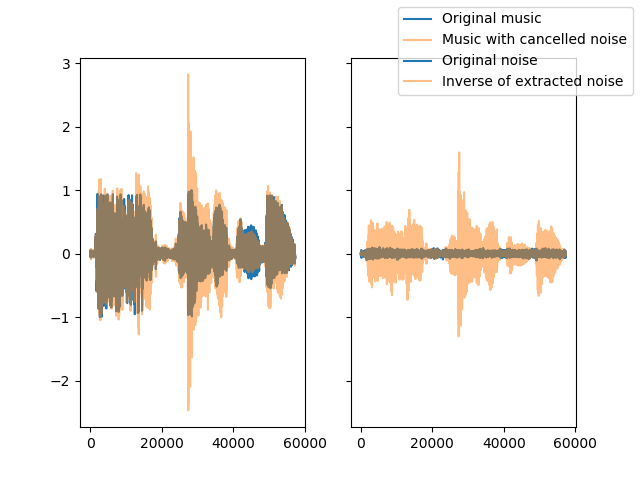

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


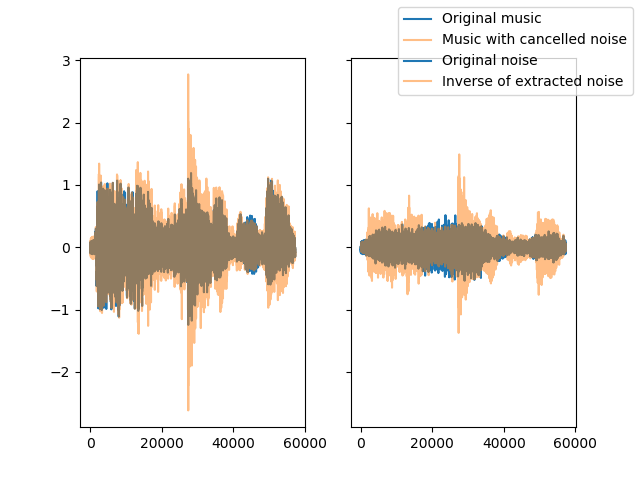

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


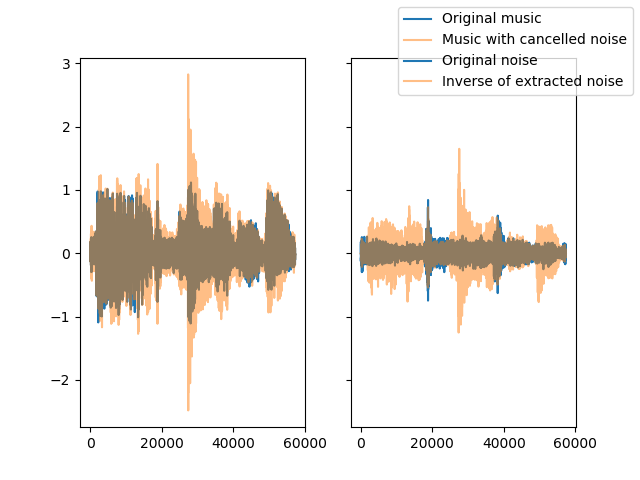

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


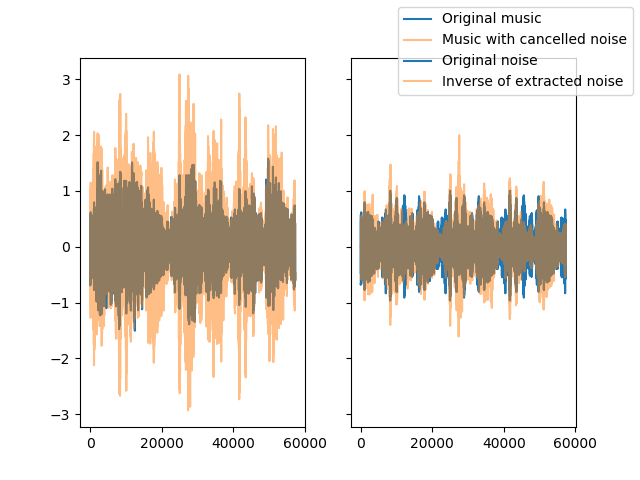

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


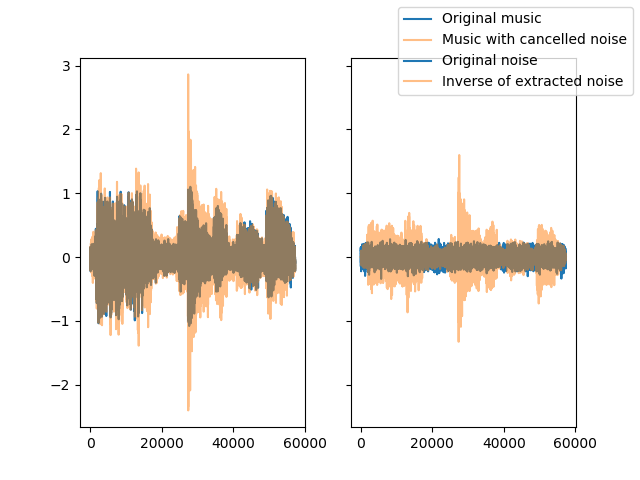

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


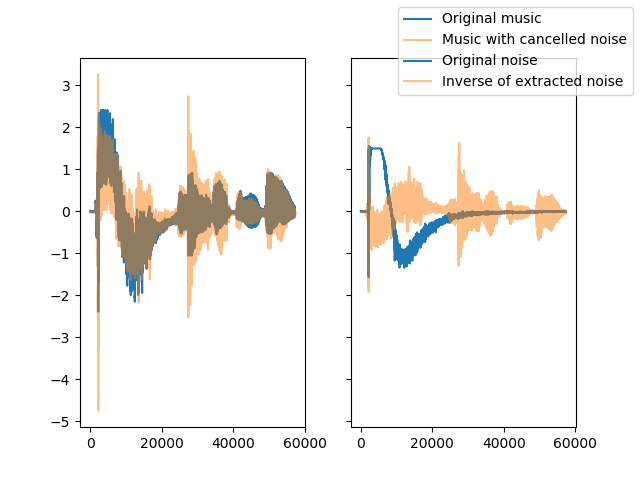

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>


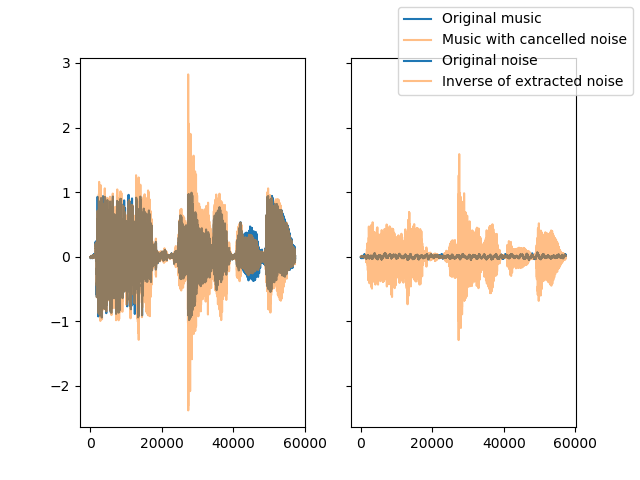

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>

Original Music


Original Noise


Noisy Music


Music with ANC


<IPython.core.display.Javascript object>

Original Music


Original Noise


Noisy Music


Music with ANC


Average MSE loss for all samples is 0.08860747854527412


In [19]:
%matplotlib notebook

calculateANC(baseFolder, "Sounds/ProcessedTest/fold0/", "GAN-ANC/GANOutput/", mult=0.04, showGraphs=True, showPlayer=True)

### Noise cancellation using a reference LMS filter

<IPython.core.display.Javascript object>


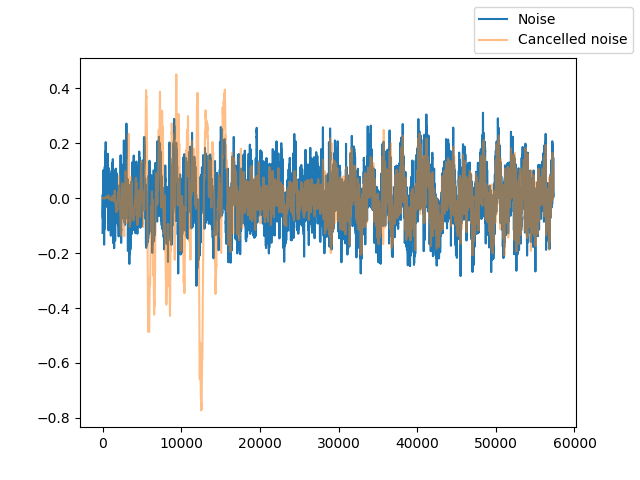

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


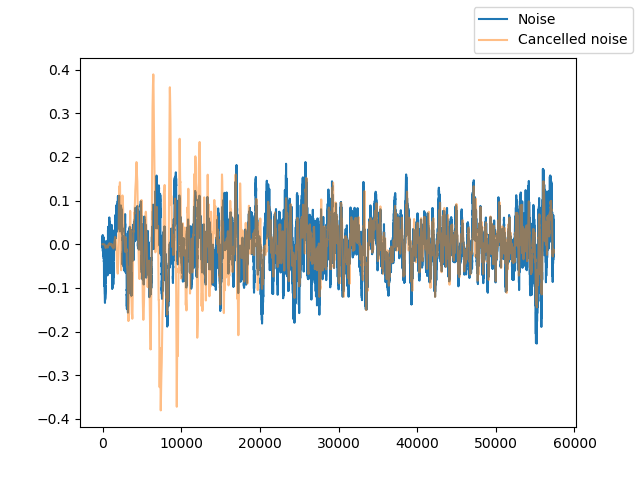

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


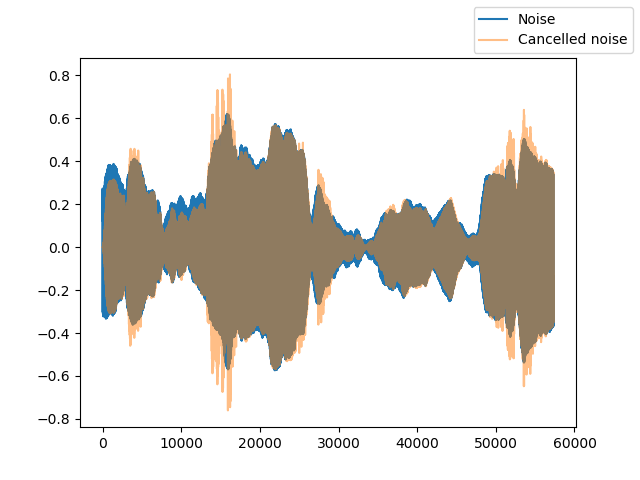

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


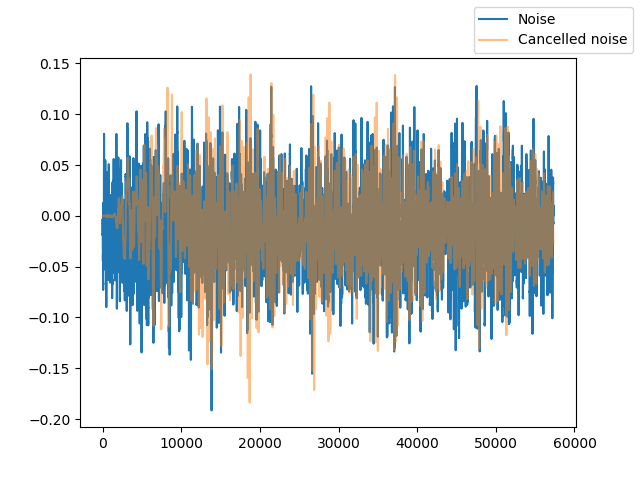

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


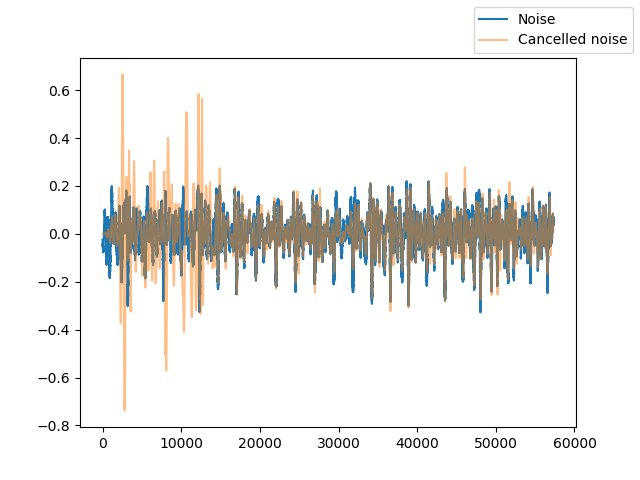

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


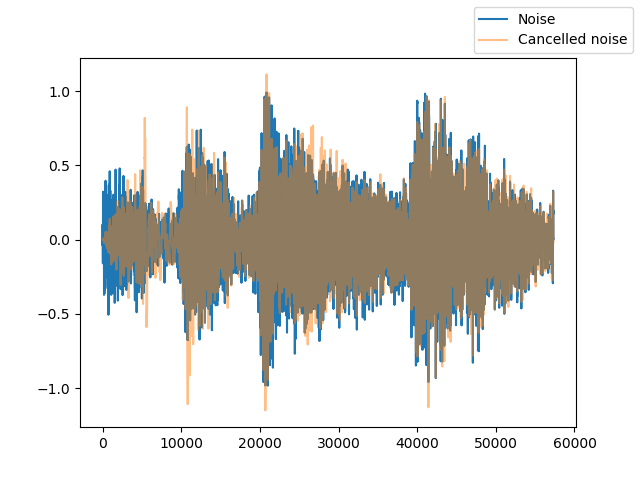

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


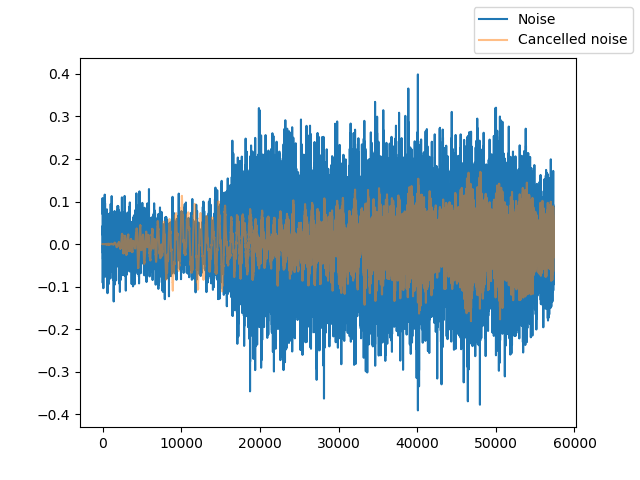

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


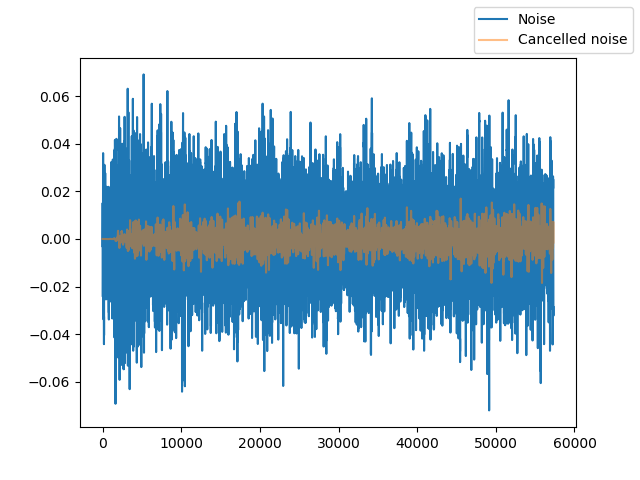

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


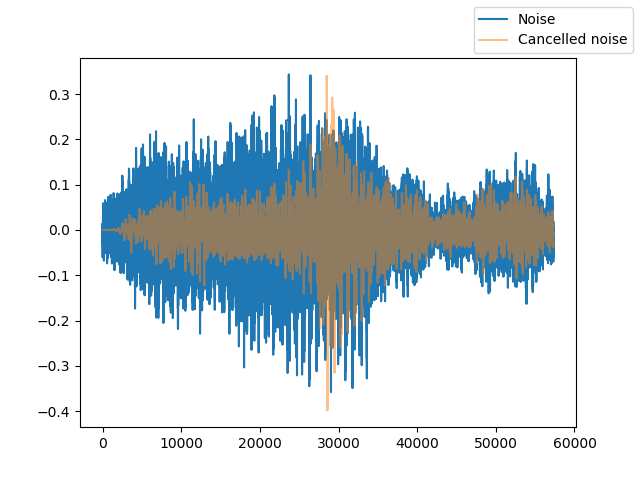

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


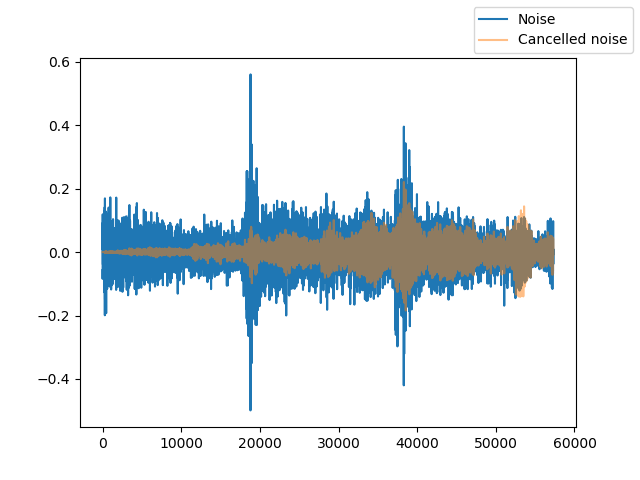

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


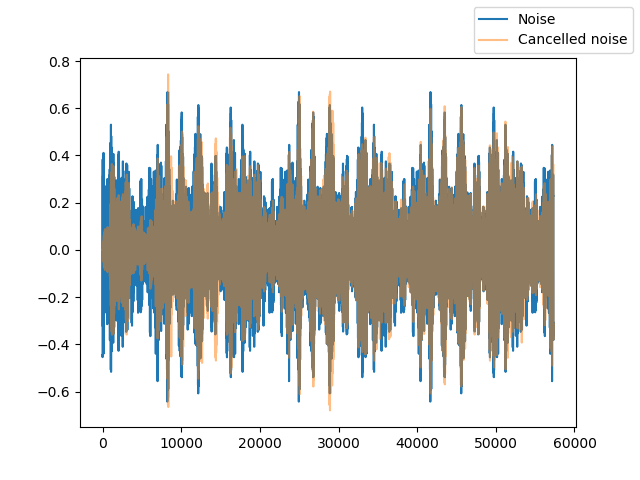

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


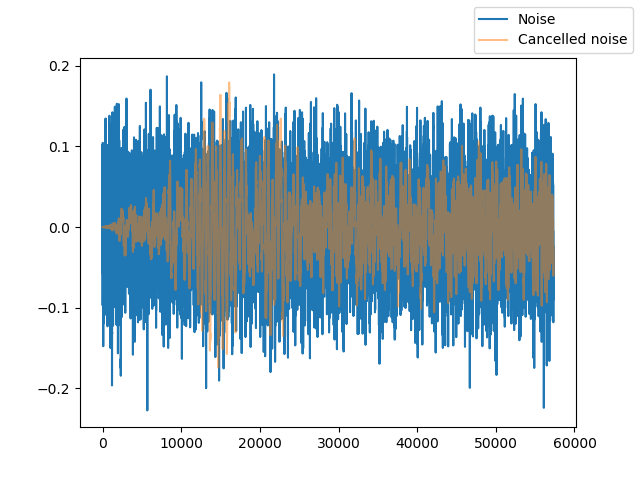

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


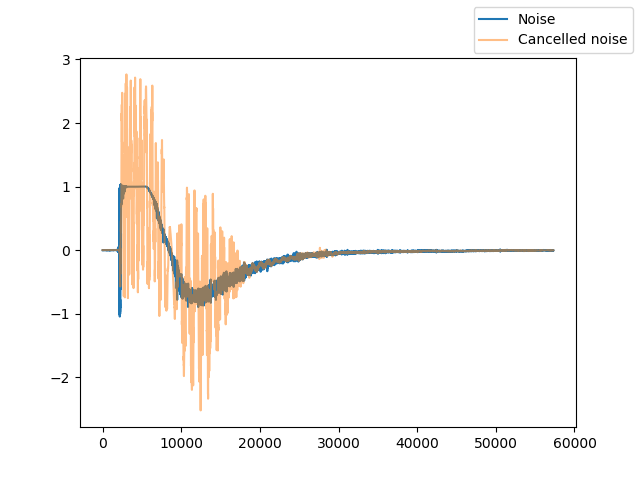

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


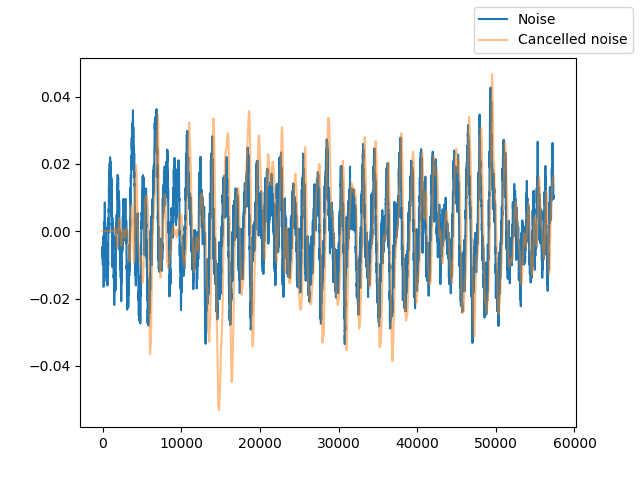

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


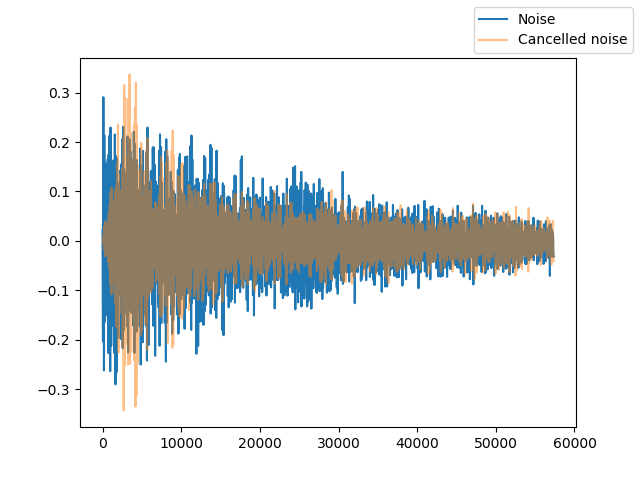

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


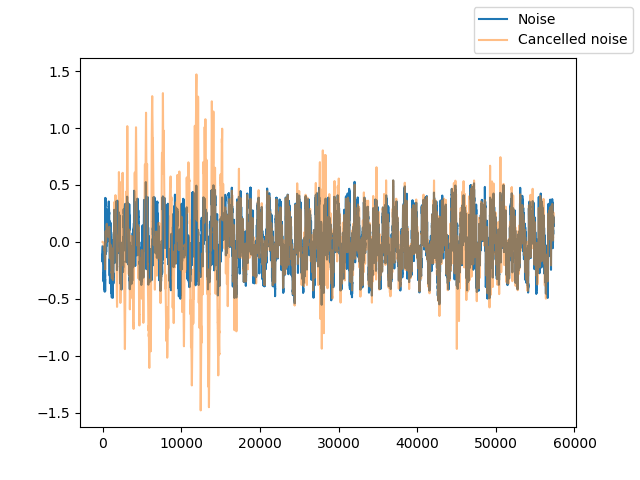

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


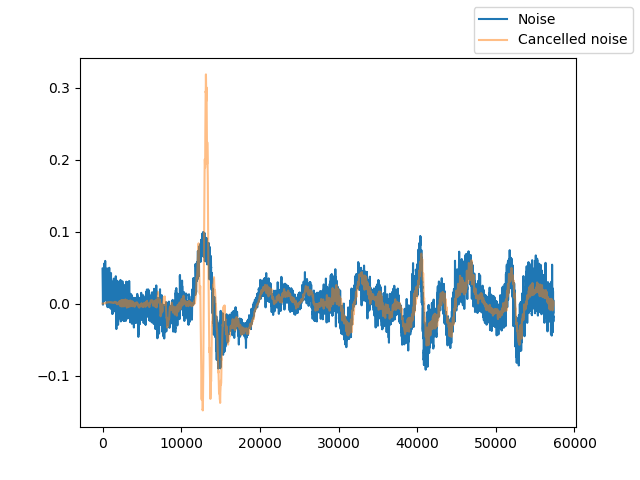

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


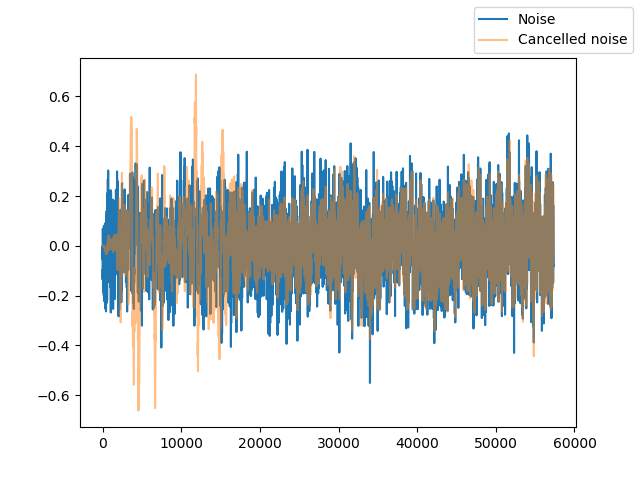

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


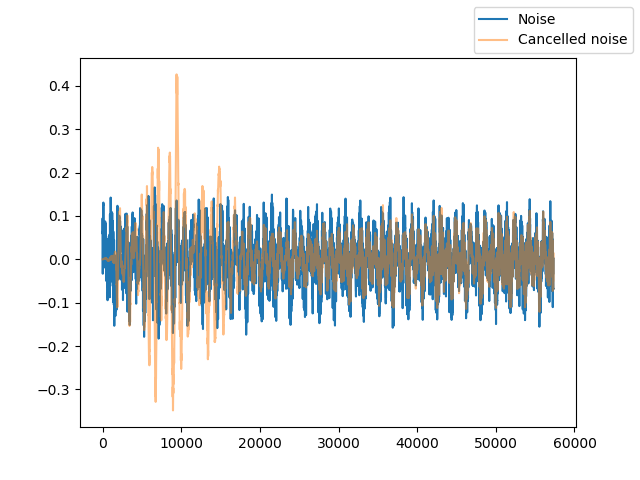

Original Noise


Noise with ANC


<IPython.core.display.Javascript object>


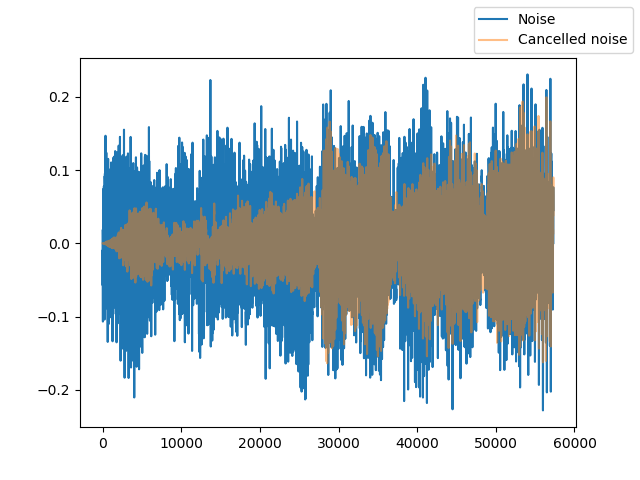

Original Noise


Noise with ANC


In [49]:
%matplotlib notebook

with open("/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/metadata.txt") as noiseMetadataFile:
    noiseFiles = [line.strip() for line in noiseMetadataFile]

baseFolder = "/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/"
metadataPath = baseFolder + "metadata.txt"
metadataFile = open(metadataPath)
metadataFData = metadataFile.read()

reg = re.compile("\/home.*\.wav")
noiseFiles = reg.findall(metadataFData)

for i in range(20):
    
    noiseData, sr = librosa.load(noiseFiles[i * 20].strip(), mono=True, sr=44100, duration=1.30)
    
    LMSFilterFile = "/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/LMS/LMSOutput/filterOutput" + str(i) + ".RAW"
    LMSFilter = sf.SoundFile(LMSFilterFile, channels=1, samplerate=44100, subtype='FLOAT').read(dtype=np.float, always_2d=False)
    LMSFilterMult = np.multiply(LMSFilter, 2.0)
    
    result = np.subtract(noiseData, LMSFilterMult)
    ax, fig = plt.subplots()
    
    fig.plot(noiseData, label="Noise", alpha=1)
    fig.plot(LMSFilterMult, label="Cancelled noise", alpha=0.5)
    ax.legend()
    
    ax.show()
    print("Original Noise")
    ipd.display(ipd.Audio(noiseData, rate=44100))
    
    print("Noise with ANC")
    ipd.display(ipd.Audio(result, rate=44100))

<IPython.core.display.Javascript object>


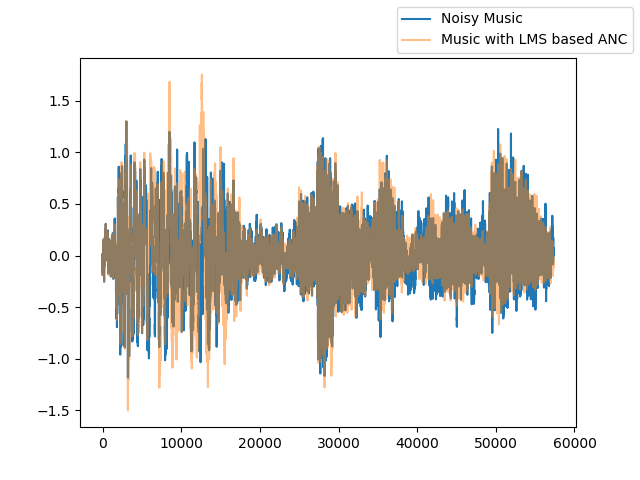

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


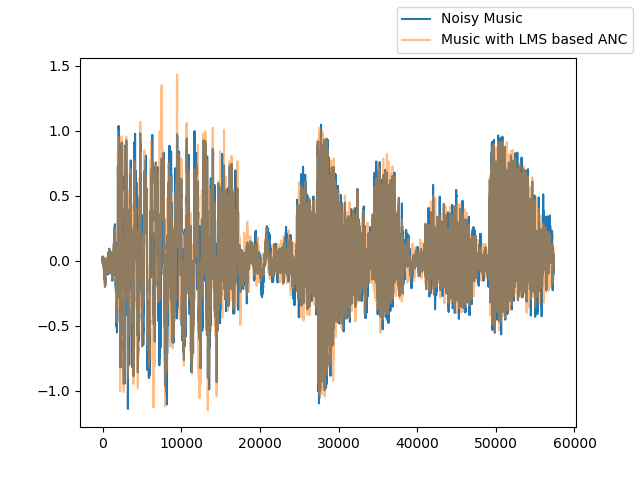

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


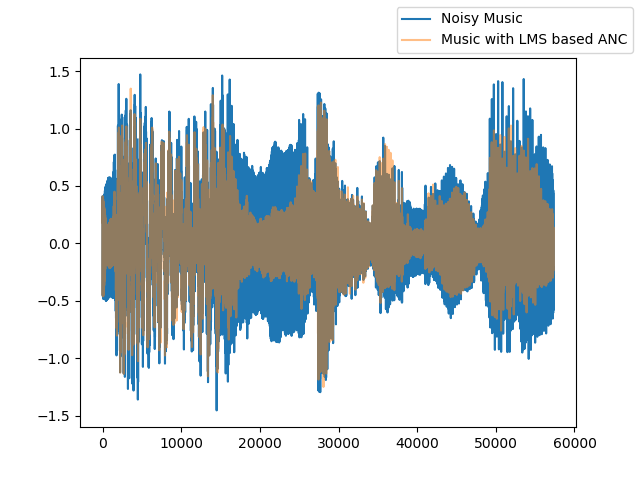

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


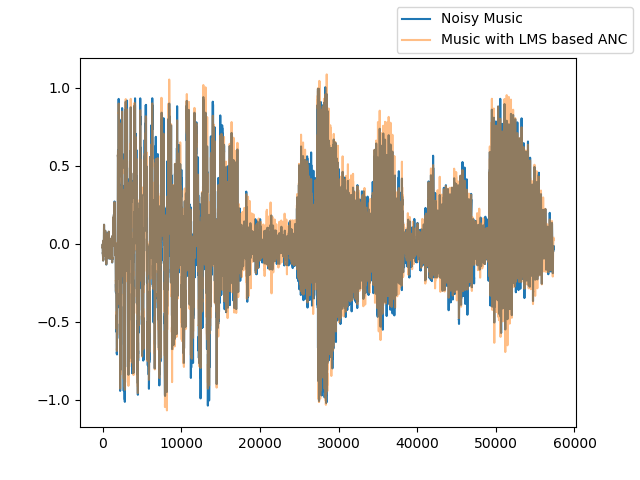

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


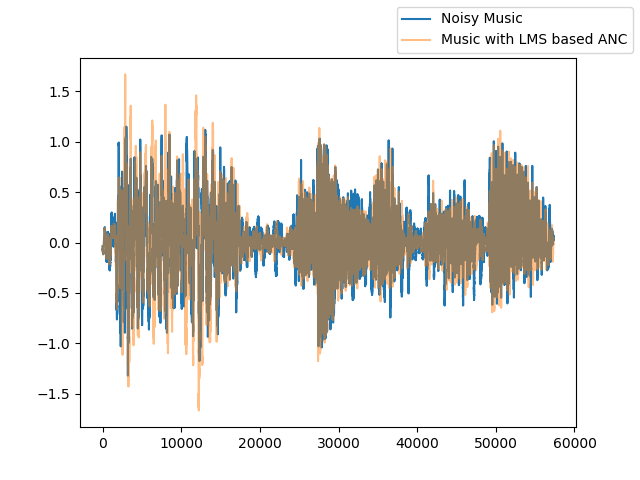

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


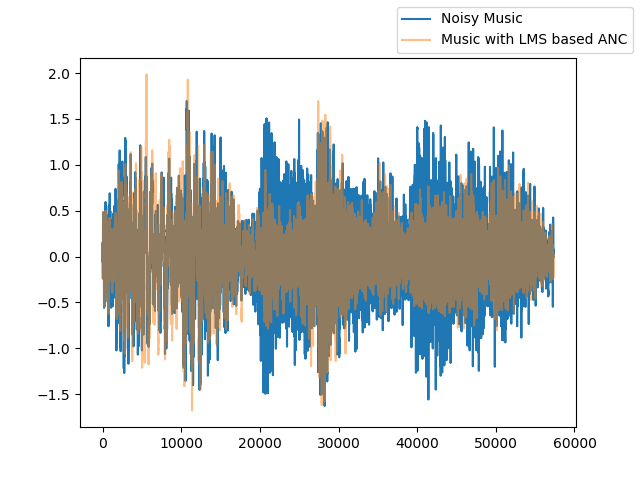

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


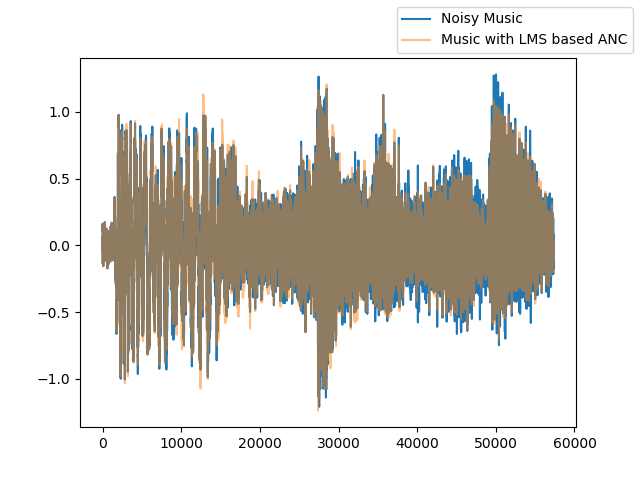

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


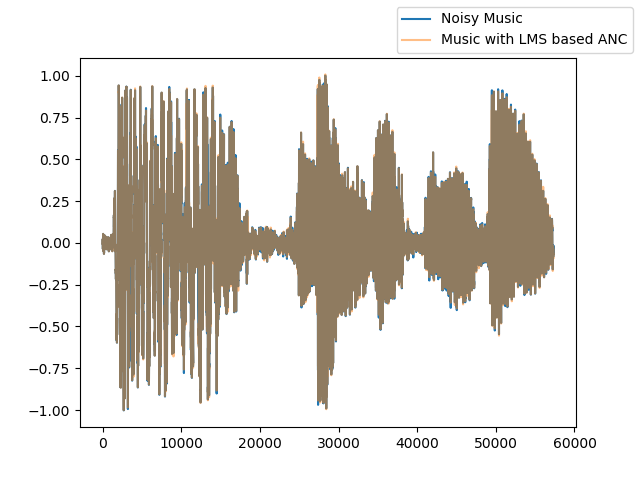

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


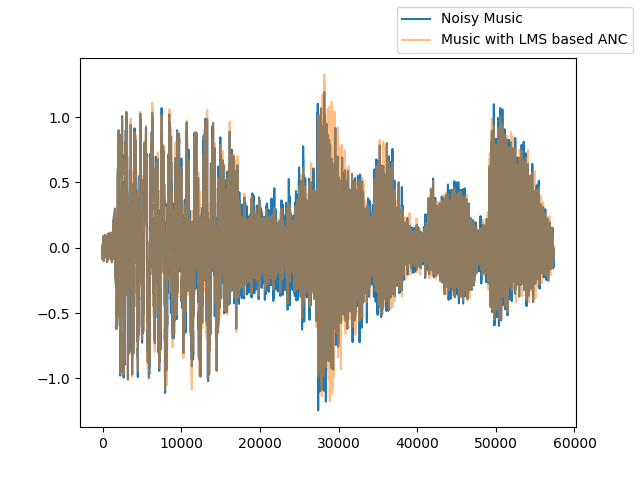

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


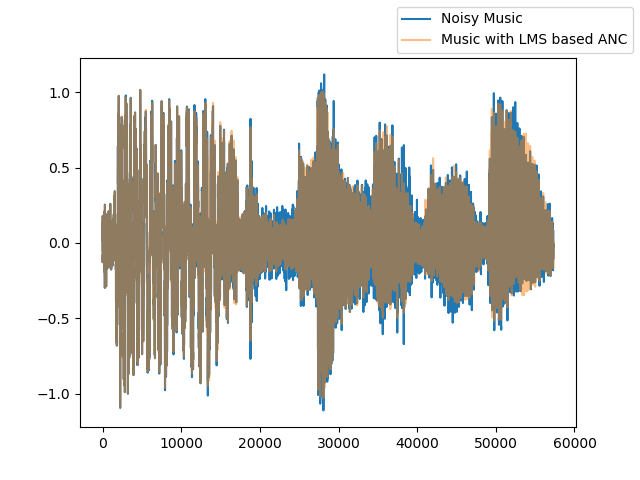

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


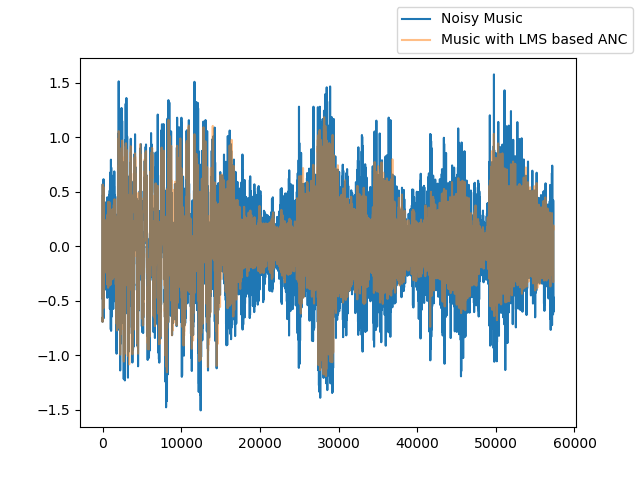

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


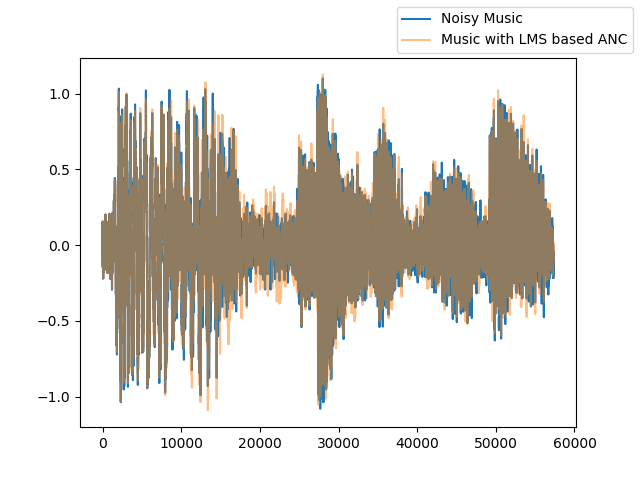

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


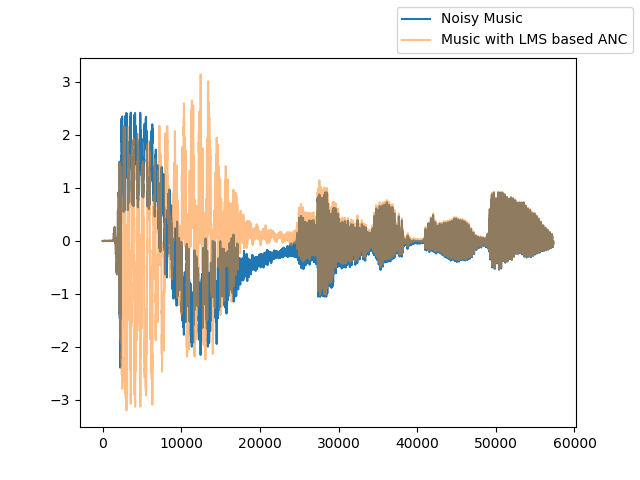

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


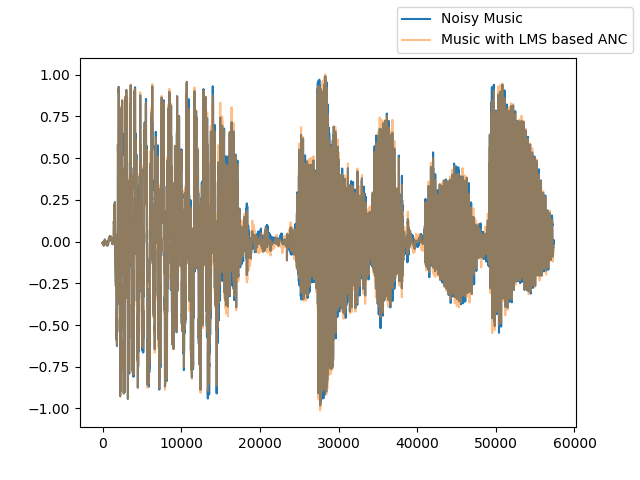

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


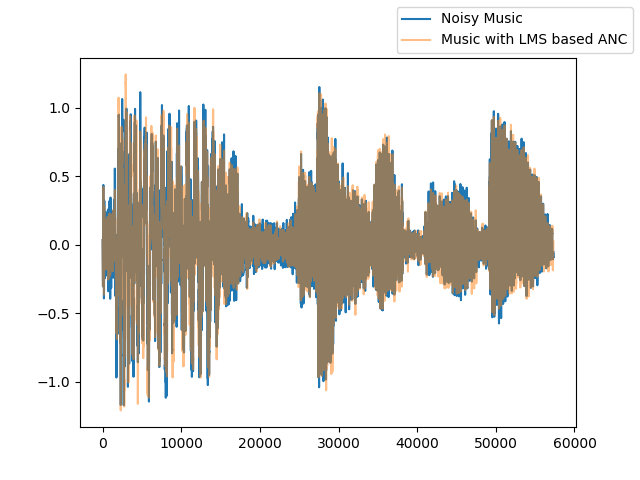

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


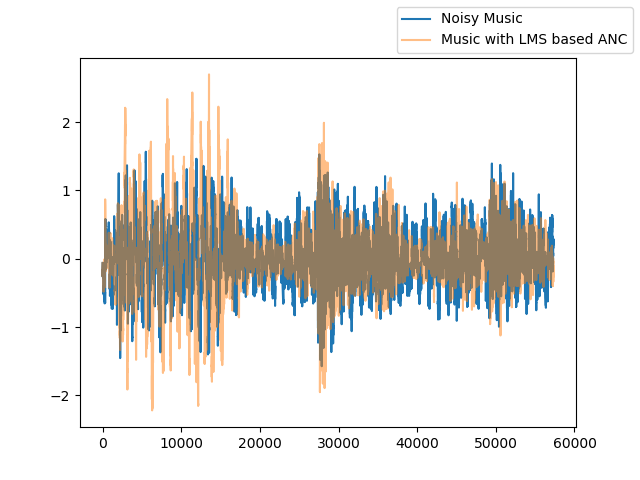

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


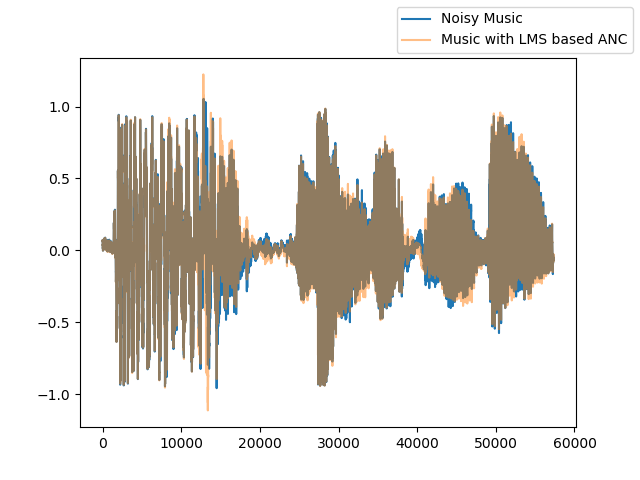

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


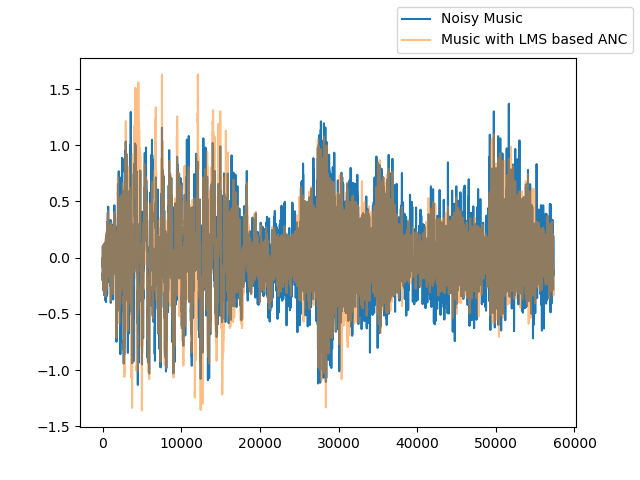

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


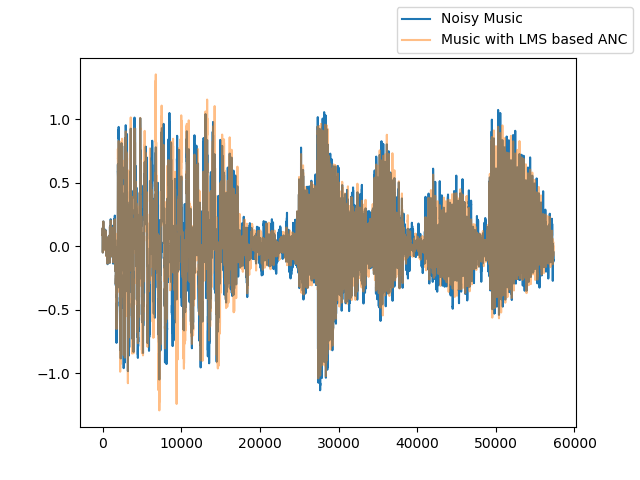

Original Noise


Noise with LMS based ANC


<IPython.core.display.Javascript object>


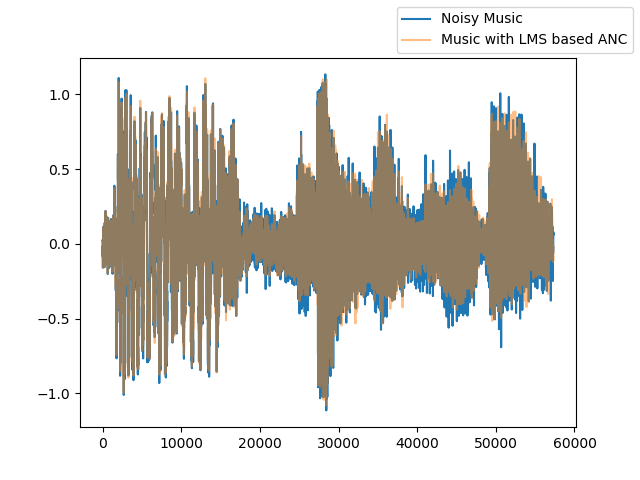

Original Noise


Noise with LMS based ANC


In [50]:
%matplotlib notebook

for i in range(20):
    
    musicFile = "/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/ProcessedTest/fold0/" + str(i * 20 + 2) + ".RAW"
    extractedMusic = sf.SoundFile(musicFile, channels=1, samplerate=44100, subtype='FLOAT').read(dtype=np.float, always_2d=False)
    
    LMSFilterFile = "/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/LMS/LMSOutput/filterOutput" + str(i) + ".RAW"
    LMSFilter = sf.SoundFile(LMSFilterFile, channels=1, samplerate=44100, subtype='FLOAT').read(dtype=np.float, always_2d=False)
    LMSFilterMult = np.multiply(LMSFilter, 4.0)
    
    result = np.subtract(extractedMusic, LMSFilterMult)
    ax, fig = plt.subplots()
    
    fig.plot(extractedMusic, label="Noisy Music", alpha=1)
    fig.plot(result, label="Music with LMS based ANC", alpha=0.5)
    ax.legend()
    
    ax.show()
    print("Original Noise")
    ipd.display(ipd.Audio(extractedMusic, rate=44100))
    
    print("Noise with LMS based ANC")
    ipd.display(ipd.Audio(result, rate=44100))

In [7]:
soundMetadata = pd.read_csv("/home/sebltm/OneDrive/Documents/Exeter/BSc_Dissertation/Sounds/UrbanSound8K/metadata/UrbanSound8K.csv")
print(soundMetadata)

         slice_file_name    fsID       start         end  salience  fold  \
0       100032-3-0-0.wav  100032    0.000000    0.317551         1     5   
1     100263-2-0-117.wav  100263   58.500000   62.500000         1     5   
2     100263-2-0-121.wav  100263   60.500000   64.500000         1     5   
3     100263-2-0-126.wav  100263   63.000000   67.000000         1     5   
4     100263-2-0-137.wav  100263   68.500000   72.500000         1     5   
...                  ...     ...         ...         ...       ...   ...   
8727     99812-1-2-0.wav   99812  159.522205  163.522205         2     7   
8728     99812-1-3-0.wav   99812  181.142431  183.284976         2     7   
8729     99812-1-4-0.wav   99812  242.691902  246.197885         2     7   
8730     99812-1-5-0.wav   99812  253.209850  255.741948         2     7   
8731     99812-1-6-0.wav   99812  332.289233  334.821332         2     7   

      classID             class  
0           3          dog_bark  
1           2  chil